In [ ]:
!pip install roboflow

from roboflow import Roboflow
rf = Roboflow(api_key="o0qlzMSdjo45PEreymoH")
project = rf.workspace("image-segmentation-awhml").project("image-segmentation-vqwee")
version = project.version(1)
dataset = version.download("coco-segmentation")


   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 85.4/85.4 kB 5.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 66.8/66.8 kB 5.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 49.9/49.9 MB 20.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 7.8/7.8 MB 66.3 MB/s eta 0:00:00
  Attempting uninstall: opencv-python-headless
    Found existing installation: opencv-python-headless 4.11.0.86
    Uninstalling opencv-python-headless-4.11.0.86:
      Successfully uninstalled opencv-python-headless-4.11.0.86
  Attempting uninstall: idna
    Found existing installation: idna 3.10
    Uninstalling idna-3.10:
      Successfully uninstalled idna-3.10
loading Roboflow workspace...
loading Roboflow project...



Extracting Dataset Version Zip to image-segmentation-1 in coco-segmentation:: 100%|██████████| 441/441 [00:00<00:00, 4498.82it/s]


In [ ]:
!pip install pyyaml==5.1

import torch
TORCH_VERSION = ".".join(torch.__version__.split(".")[:2])
CUDA_VERSION = torch.__version__.split("+")[-1]
print("torch: ", TORCH_VERSION, "; cuda: ", CUDA_VERSION)
# Install detectron2 that matches the above pytorch version
# See https://detectron2.readthedocs.io/tutorials/install.html for instructions
# !pip install detectron2 -f https://dl.fbaipublicfiles.com/detectron2/wheels/$CUDA_VERSION/torch$TORCH_VERSION/index.html
# If there is not yet a detectron2 release that matches the given torch + CUDA version, you need to install a different pytorch.
!python -m pip install 'git+https://github.com/facebookresearch/detectron2.git'
# exit(0)  # After installation, you may need to "restart runtime" in Colab. This line can also restart runtime

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 274.2/274.2 kB 15.5 MB/s eta 0:00:00
  error: subprocess-exited-with-error
  
  × python setup.py egg_info did not run successfully.
  │ exit code: 1
  ╰─> See above for output.
  
  note: This error originates from a subprocess, and is likely not a problem with pip.
  Preparing metadata (setup.py) ... error
error: metadata-generation-failed

× Encountered error while generating package metadata.
╰─> See above for output.

note: This is an issue with the package mentioned above, not pip.
hint: See above for details.
torch:  2.6 ; cuda:  cu124
  Cloning https://github.com/facebookresearch/detectron2.git to /tmp/pip-req-build-a9k3bd2j
  Running command git clone --filter=blob:none --quiet https://github.com/facebookresearch/detectron2.git /tmp/pip-req-build-a9k3bd2j
  Resolved https://github.com/facebookresearch/detectron2.git to commit 65184fc057d4fab080a98564f6b60fae0b94edc4
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━

In [ ]:
# Some basic setup:
# Setup detectron2 logger
import detectron2
from detectron2.utils.logger import setup_logger
setup_logger()

# import some common libraries
import numpy as np
import os, json, cv2, random
from google.colab.patches import cv2_imshow

# import some common detectron2 utilities
from detectron2 import model_zoo
from detectron2.engine import DefaultPredictor
from detectron2.config import get_cfg
from detectron2.utils.visualizer import Visualizer
from detectron2.data import MetadataCatalog, DatasetCatalog

In [ ]:
from detectron2.data.datasets import register_coco_instances
register_coco_instances('train',{},'/content/image-segmentation-1/train/_annotations.coco.json','/content/image-segmentation-1/train')
register_coco_instances('val',{},'/content/image-segmentation-1/valid/_annotations.coco.json','/content/image-segmentation-1/valid')

In [ ]:
metadata=MetadataCatalog.get('train')
dataset_dicts=DatasetCatalog.get('train')

WARNING [05/23 14:37:16 d2.data.datasets.coco]: 
Category ids in annotations are not in [1, #categories]! We'll apply a mapping for you.

[05/23 14:37:16 d2.data.datasets.coco]: Loaded 303 images in COCO format from /content/image-segmentation-1/train/_annotations.coco.json


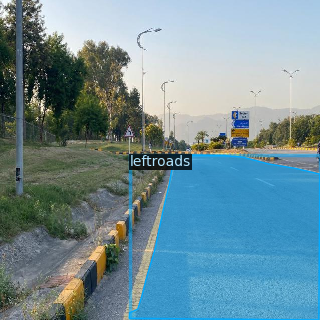

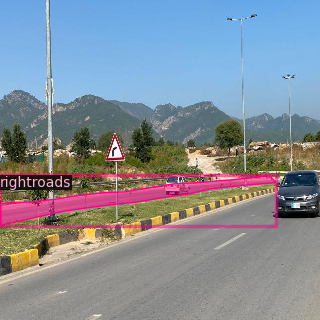

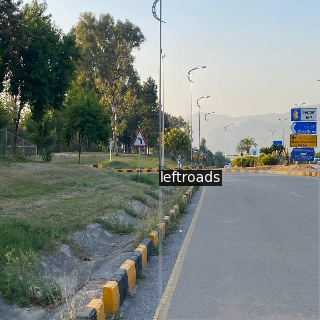

In [ ]:
import random

for d in random.sample(dataset_dicts,3):
  img=cv2.imread(d['file_name'])
  visualizer=Visualizer(img[:,:,::-1],metadata=metadata,scale=0.5)
  vis = visualizer.draw_dataset_dict(d)
  cv2_imshow(vis.get_image()[:, :, ::-1])

In [ ]:
from detectron2.engine import DefaultTrainer

cfg=get_cfg()
cfg.merge_from_file(model_zoo.get_config_file('COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x.yaml'))
cfg.DATASETS.TRAIN = ('train',)
cfg.DATASETS.TEST = ('val',)
cfg.DATALOADER.NUM_WORKERS = 2
cfg.MODEL.WEIGHTS = model_zoo.get_checkpoint_url("COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x.yaml")  # Let training initialize from model zoo
cfg.SOLVER.IMS_PER_BATCH = 2
cfg.SOLVER.BASE_LR = 0.0025  # pick a good LR
cfg.SOLVER.MAX_ITER = 300    # 300 iterations seems good enough for this toy dataset; you will need to train longer for a practical dataset
cfg.MODEL.ROI_HEADS.BATCH_SIZE_PER_IMAGE = 128   # faster, and good enough for this toy dataset (default: 512)
cfg.MODEL.ROI_HEADS.NUM_CLASSES = 14  # (see https://detectron2.readthedocs.io/tutorials/datasets.html#update-the-config-for-new-datasets)
# NOTE: this config means the number of classes, but a few popular unofficial tutorials incorrect uses num_classes+1 here.

os.makedirs(cfg.OUTPUT_DIR, exist_ok=True)
trainer = DefaultTrainer(cfg)
trainer.resume_or_load(resume=False)
trainer.train()

[05/23 14:40:48 d2.engine.defaults]: Model:
GeneralizedRCNN(
  (backbone): FPN(
    (fpn_lateral2): Conv2d(256, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output2): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral3): Conv2d(512, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output3): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral4): Conv2d(1024, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output4): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral5): Conv2d(2048, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output5): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (top_block): LastLevelMaxPool()
    (bottom_up): ResNet(
      (stem): BasicStem(
        (conv1): Conv2d(
          3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False
          (norm): FrozenBatchNorm2d(num_features=64, eps=1e-05)
        )
      )
      (res

model_final_f10217.pkl: 178MB [00:02, 85.7MB/s]                           
roi_heads.box_predictor.bbox_pred.{bias, weight}
roi_heads.box_predictor.cls_score.{bias, weight}
roi_heads.mask_head.predictor.{bias, weight}


[05/23 14:40:50 d2.engine.train_loop]: Starting training from iteration 0


torch.meshgrid: in an upcoming release, it will be required to pass the indexing argument. (Triggered internally at /pytorch/aten/src/ATen/native/TensorShape.cpp:3637.)


[05/23 14:41:00 d2.utils.events]:  eta: 0:01:28  iter: 19  total_loss: 3.201  loss_cls: 2.391  loss_box_reg: 0.06505  loss_mask: 0.6858  loss_rpn_cls: 0.07917  loss_rpn_loc: 0.008244    time: 0.3050  last_time: 0.2561  data_time: 0.0174  last_data_time: 0.0109   lr: 0.00016068  max_mem: 1769M
[05/23 14:41:10 d2.utils.events]:  eta: 0:01:19  iter: 39  total_loss: 1.146  loss_cls: 0.333  loss_box_reg: 0.2144  loss_mask: 0.5851  loss_rpn_cls: 0.02038  loss_rpn_loc: 0.007632    time: 0.3055  last_time: 0.3404  data_time: 0.0095  last_data_time: 0.0108   lr: 0.00032718  max_mem: 1769M
[05/23 14:41:16 d2.utils.events]:  eta: 0:01:12  iter: 59  total_loss: 1.28  loss_cls: 0.3482  loss_box_reg: 0.4141  loss_mask: 0.4818  loss_rpn_cls: 0.01461  loss_rpn_loc: 0.004932    time: 0.3013  last_time: 0.3467  data_time: 0.0056  last_data_time: 0.0043   lr: 0.00049367  max_mem: 1770M
[05/23 14:41:24 d2.utils.events]:  eta: 0:01:07  iter: 79  total_loss: 0.9367  loss_cls: 0.2854  loss_box_reg: 0.4027  l

In [ ]:
cfg.MODEL.WEIGHTS = os.path.join(cfg.OUTPUT_DIR, "model_final.pth")
cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.5   # set the testing threshold for this model
cfg.DATASETS.TEST = ("val", )
predictor = DefaultPredictor(cfg)

[05/23 14:44:04 d2.checkpoint.detection_checkpoint]: [DetectionCheckpointer] Loading from ./output/model_final.pth ...


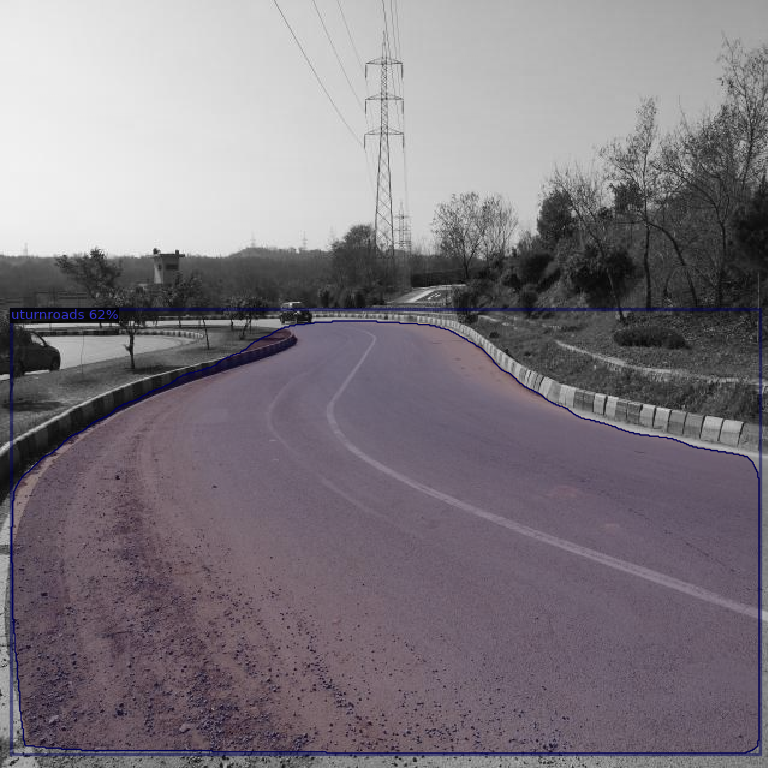

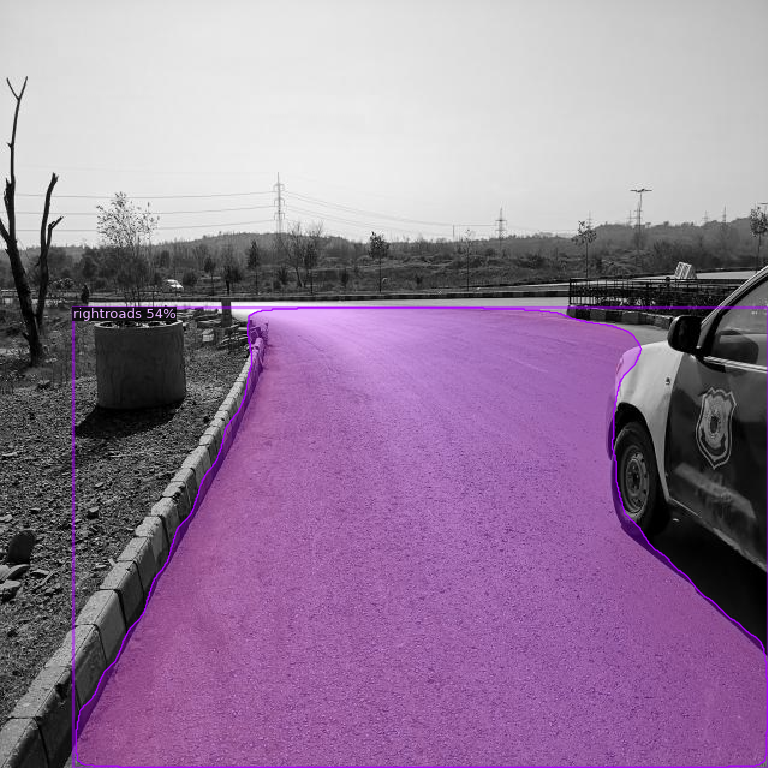

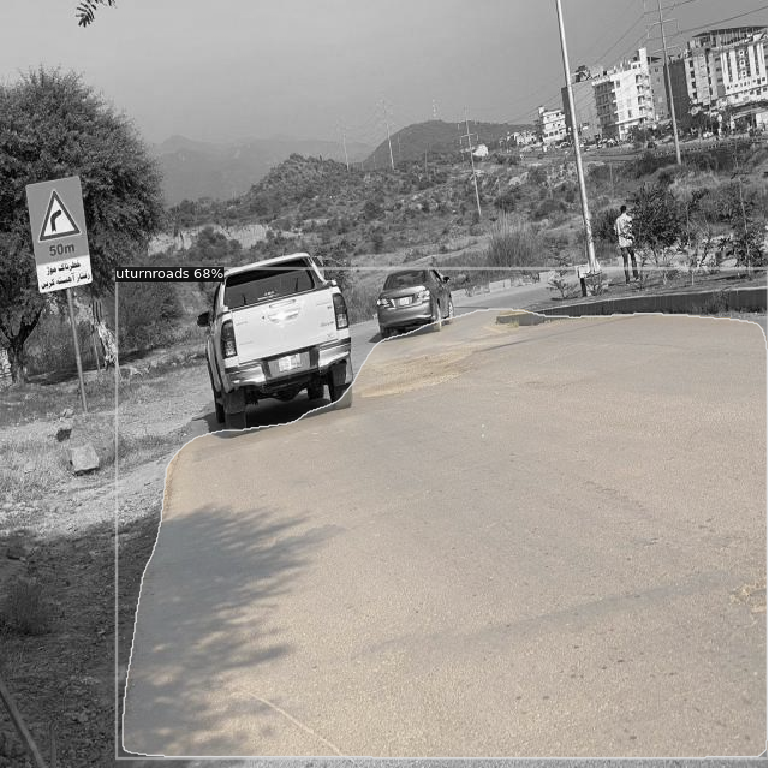

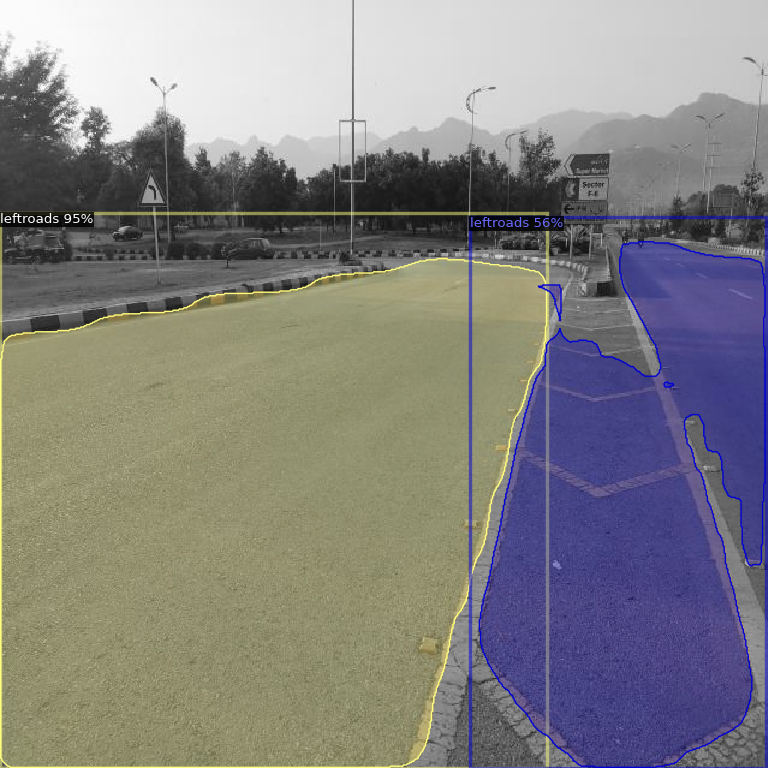

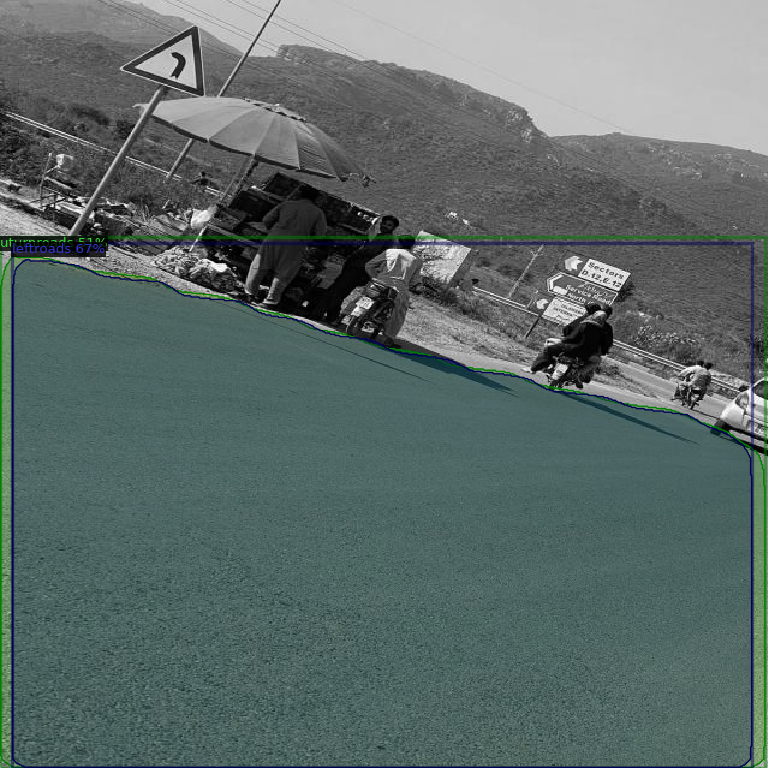

...

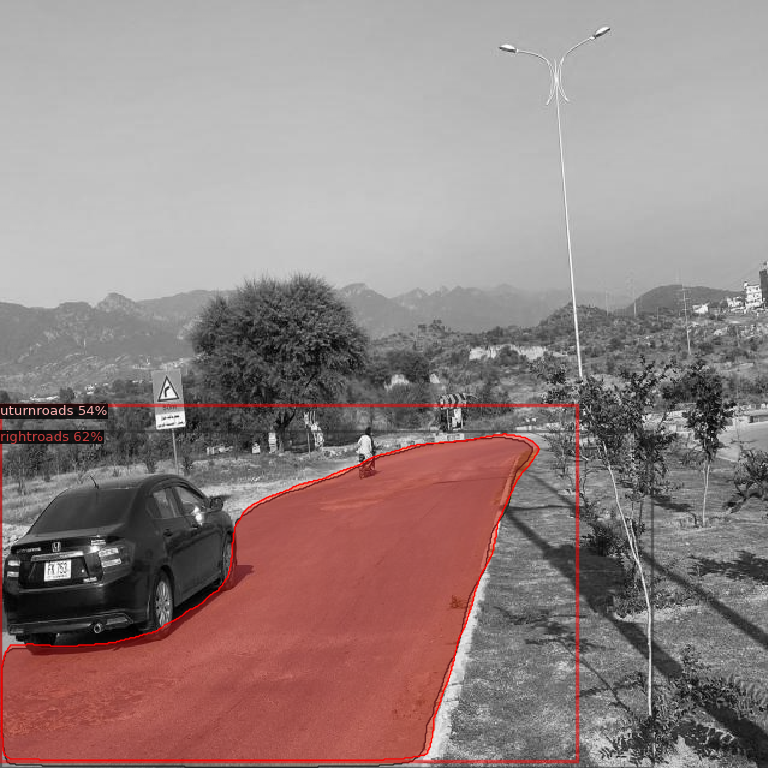

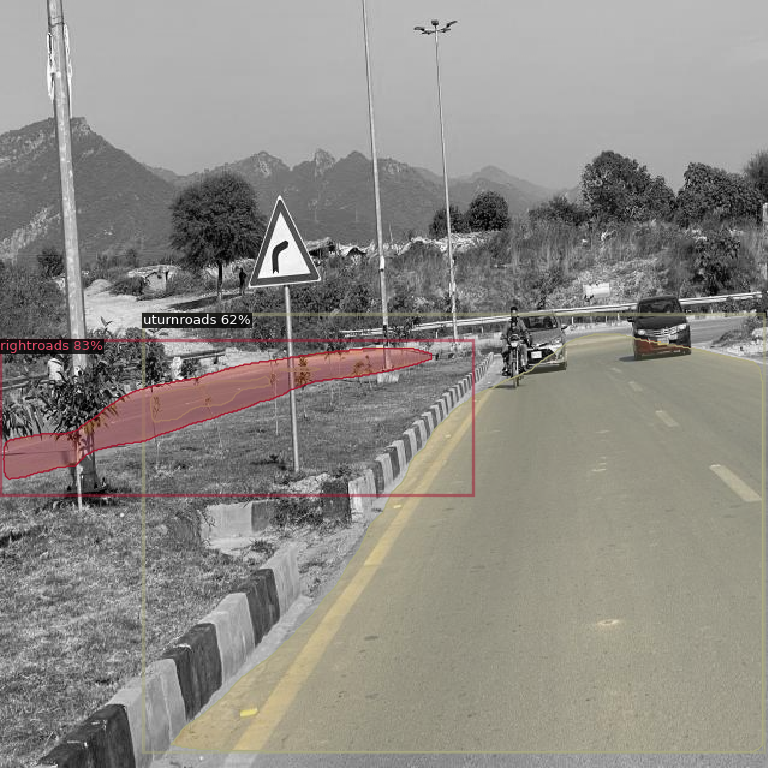

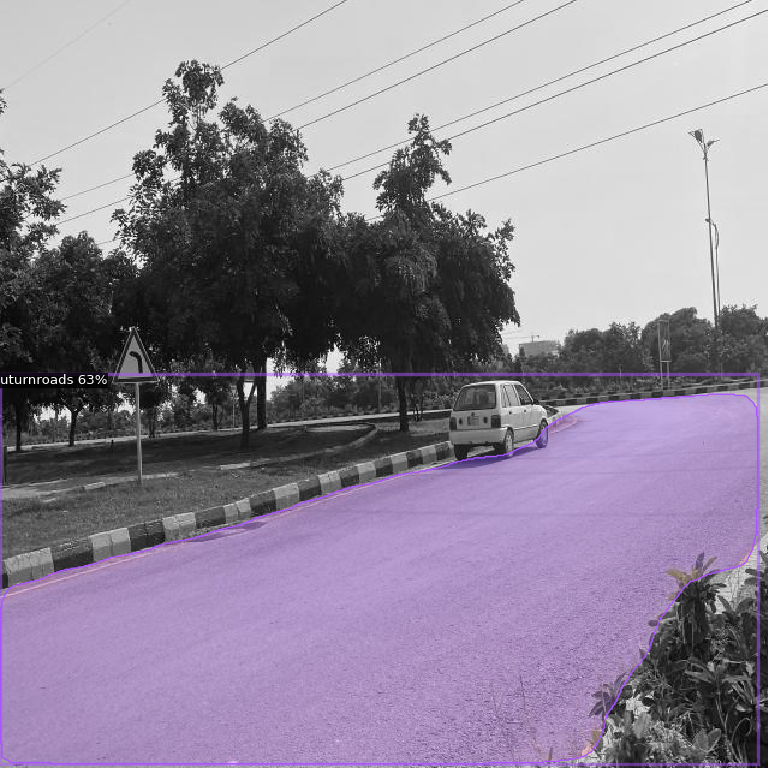

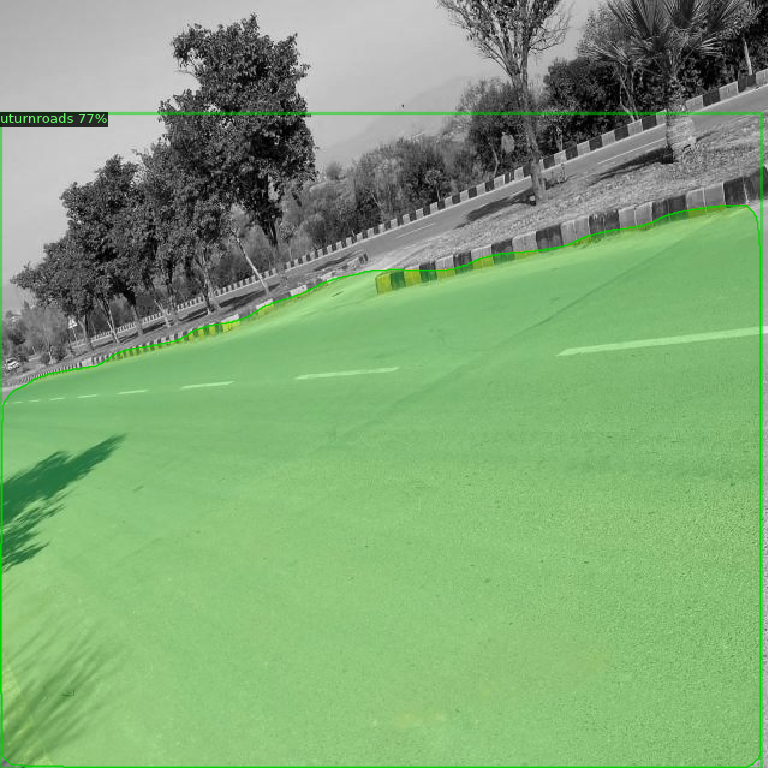

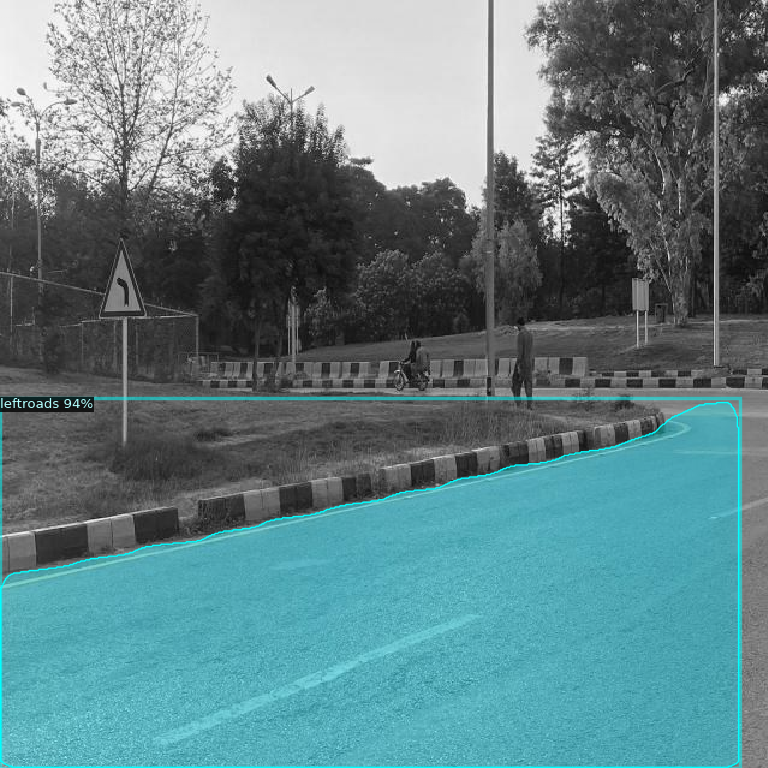

In [ ]:
from detectron2.utils.visualizer import ColorMode
import os

data_path = "/content/image-segmentation-1/test"

for d in os.listdir("/content/image-segmentation-1/test"):
    if not d.lower().endswith(('.jpg', '.jpeg', '.png')):
        continue
    img_path=os.path.join(data_path, d)
    im = cv2.imread(img_path)
    outputs = predictor(im)
    v = Visualizer(im[:, :, ::-1],
                   metadata=metadata,
                   scale=1.2,
                   instance_mode=ColorMode.IMAGE_BW   # remove the colors of unsegmented pixels
    )
    v = v.draw_instance_predictions(outputs["instances"].to("cpu"))
    cv2_imshow(v.get_image()[:, :, ::-1])

In [ ]:
from detectron2.evaluation import COCOEvaluator, inference_on_dataset
from detectron2.data import build_detection_test_loader
evaluator = COCOEvaluator("train", output_dir= "./output")
val_loader = build_detection_test_loader(cfg, "train")
print(inference_on_dataset(predictor.model, val_loader, evaluator))

WARNING [05/23 14:46:18 d2.data.datasets.coco]: 
Category ids in annotations are not in [1, #categories]! We'll apply a mapping for you.

[05/23 14:46:18 d2.data.datasets.coco]: Loaded 303 images in COCO format from /content/image-segmentation-1/train/_annotations.coco.json
[05/23 14:46:18 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[05/23 14:46:18 d2.data.common]: Serializing the dataset using: <class 'detectron2.data.common._TorchSerializedList'>
[05/23 14:46:18 d2.data.common]: Serializing 303 elements to byte tensors and concatenating them all ...
[05/23 14:46:18 d2.data.common]: Serialized dataset takes 0.33 MiB
[05/23 14:46:18 d2.evaluation.evaluator]: Start inference on 303 batches
[05/23 14:46:19 d2.evaluation.evaluator]: Inference done 11/303. Dataloading: 0.0026 s/iter. Inference: 0.0839 s/iter. Eval: 0.0014 s/iter. Total: 0.0880 s/iter. ETA=0:00:25
[05/23 14

In [ ]:
f = open('config.yml', 'w')
f.write(cfg.dump())
f.close()